In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import os
from datetime import datetime
import pandas as pd
import plotly.express as px

from sklearn.ensemble import IsolationForest

mpl.rcParams['figure.figsize'] = (15, 8)
mpl.rcParams['axes.grid'] = False

import warnings
warnings.filterwarnings('ignore')

In [2]:
df_all = pd.read_csv('datasets/All_months.csv')
df_all

,MeterID,DATE-Time,KWH
0,6200093839,2021-01-01 00:00:00,0.602
1,6200093839,2021-01-01 00:15:00,0.589
2,6200093839,2021-01-01 00:30:00,0.410
3,6200093839,2021-01-01 00:45:00,0.495
4,6200093839,2021-01-01 01:00:00,0.450
...,...,...,...
287339225,6200060529,2021-12-31 22:45:00,0.038
287339226,6200060529,2021-12-31 23:00:00,0.049
287339227,6200060529,2021-12-31 23:15:00,0.024
287339228,6200060529,2021-12-31 23:30:00,0.045


In [3]:
print(df_all["MeterID"].unique())
print(len(df_all["MeterID"].unique()))

[6200093839 6200093048 6200085183 ... 6200101198 6200068147 6200060529]
8535


In [4]:
user_1 = df_all[df_all["MeterID"] == df_all["MeterID"].unique()[0]]
user_1

,MeterID,DATE-Time,KWH
0,6200093839,2021-01-01 00:00:00,0.602
1,6200093839,2021-01-01 00:15:00,0.589
2,6200093839,2021-01-01 00:30:00,0.410
3,6200093839,2021-01-01 00:45:00,0.495
4,6200093839,2021-01-01 01:00:00,0.450
...,...,...,...
262129436,6200093839,2021-12-31 22:45:00,0.405
262129437,6200093839,2021-12-31 23:00:00,0.349
262129438,6200093839,2021-12-31 23:15:00,0.305
262129439,6200093839,2021-12-31 23:30:00,0.398


In [5]:
user_1['DATE-Time'] = pd.to_datetime(user_1['DATE-Time'], infer_datetime_format=True)
user_1.drop(columns="MeterID", inplace=True)
user_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32760 entries, 0 to 262129440
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   DATE-Time  32760 non-null  datetime64[ns]
 1   KWH        32760 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 767.8 KB


In [6]:
# I have `'DATE-Time'` 32760 rows (32760/96=341.25 Days)
# It should be (365day * 96point = 35040 rows)
# I have to reset index in order to hava 35040 rows
user_1 = user_1.set_index('DATE-Time').resample("15T").mean().reset_index()
user_1

,DATE-Time,KWH
0,2021-01-01 00:00:00,0.602
1,2021-01-01 00:15:00,0.589
2,2021-01-01 00:30:00,0.410
3,2021-01-01 00:45:00,0.495
4,2021-01-01 01:00:00,0.450
...,...,...
35035,2021-12-31 22:45:00,0.405
35036,2021-12-31 23:00:00,0.349
35037,2021-12-31 23:15:00,0.305
35038,2021-12-31 23:30:00,0.398


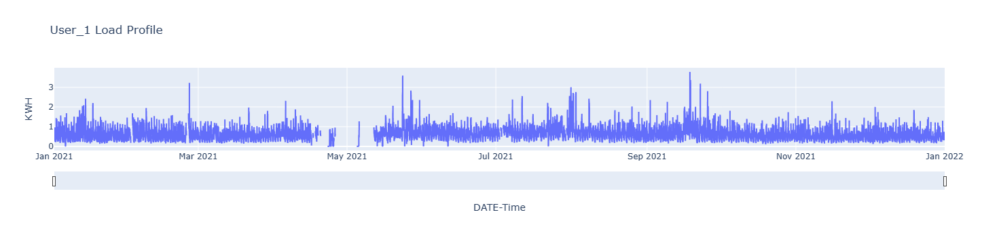

In [9]:
# Examine User_1
fig = px.line(user_1.reset_index(), x='DATE-Time', y='KWH', title='User_1 Load Profile')

fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

In [8]:
# Check Missing Value
user_1.isnull().sum()

DATE-Time       0
KWH          2280
dtype: int64

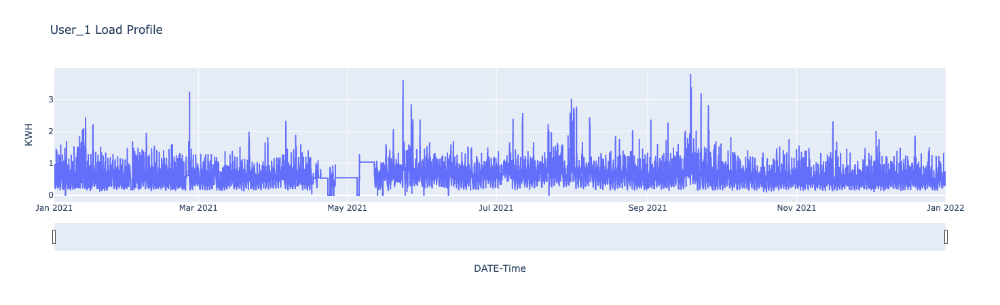

In [9]:
# Fill the missing value
user_1 = user_1.set_index('DATE-Time').resample("15T").mean().fillna(method="ffill").reset_index()

# Examine User_1
fig = px.line(user_1.reset_index(), x='DATE-Time', y='KWH', title='User_1 Load Profile')

fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

# Feature Engineering

In [13]:
# Create a quarter column
user_1['quarter'] = (user_1['DATE-Time'].dt.hour * 4) + (user_1['DATE-Time'].dt.minute // 15)

# Create an hour column
user_1['hour'] = user_1['DATE-Time'].dt.hour

# Create a weekday column
user_1['weekday'] = pd.Categorical(user_1["DATE-Time"].dt.strftime('%A'),   # '%A' represents to Weekday as locale’s full name.
                             categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday', 'Sunday'],
                             ordered=True)

# Add the "day_or_night" feature based on the "quarter" column
# 1_create a day_night function
# def day_night(quarter):
#     if quarter in range(24, 72):
#         return 'day'
#     else:
#         return 'night'
    
# user_1['day_or_night'] = user_1['quarter'].apply(day_night)

# 2_use one line of code (reccommended this)
user_1['day_or_night'] = user_1['quarter'].apply(lambda x: 'day' if x in range(24, 72) else 'night').astype('category')

user_1

,DATE-Time,KWH,quarter,hour,weekday,day_or_night
0,2021-01-01 00:00:00,0.602,0,0,Friday,night
1,2021-01-01 00:15:00,0.589,1,0,Friday,night
2,2021-01-01 00:30:00,0.410,2,0,Friday,night
3,2021-01-01 00:45:00,0.495,3,0,Friday,night
4,2021-01-01 01:00:00,0.450,4,1,Friday,night
...,...,...,...,...,...,...
35035,2021-12-31 22:45:00,0.405,91,22,Friday,night
35036,2021-12-31 23:00:00,0.349,92,23,Friday,night
35037,2021-12-31 23:15:00,0.305,93,23,Friday,night
35038,2021-12-31 23:30:00,0.398,94,23,Friday,night


In [14]:
# print(user_1['weekday'].unique())
# print(len(user_1['weekday'].unique()))

In [15]:
user_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35040 entries, 0 to 35039
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   DATE-Time     35040 non-null  datetime64[ns]
 1   KWH           35040 non-null  float64       
 2   quarter       35040 non-null  int64         
 3   hour          35040 non-null  int64         
 4   weekday       35040 non-null  category      
 5   day_or_night  35040 non-null  category      
dtypes: category(2), datetime64[ns](1), float64(1), int64(2)
memory usage: 1.1 MB


In [17]:
# user_1[['KWH','quarter']].groupby('quarter').mean().plot();

In [18]:
# user_1[['KWH','hour']].groupby('hour').mean().plot();

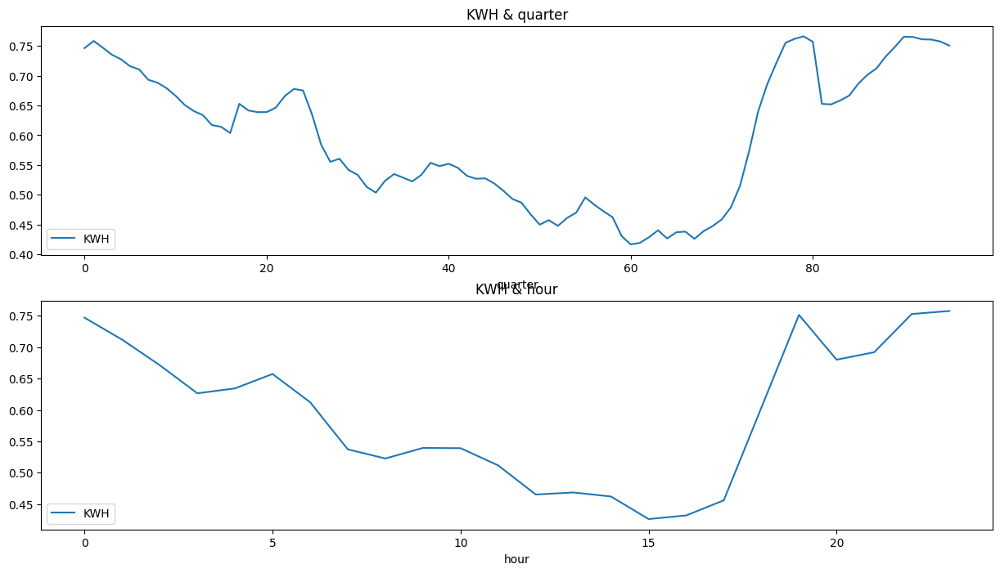

In [19]:
fig, axs = plt.subplots(2)

user_1[['KWH', 'quarter']].groupby('quarter').mean().plot(ax=axs[0])
user_1[['KWH', 'hour']].groupby('hour').mean().plot(ax=axs[1])

axs[0].set_title('KWH & quarter')
axs[1].set_title('KWH & hour')
plt.show()

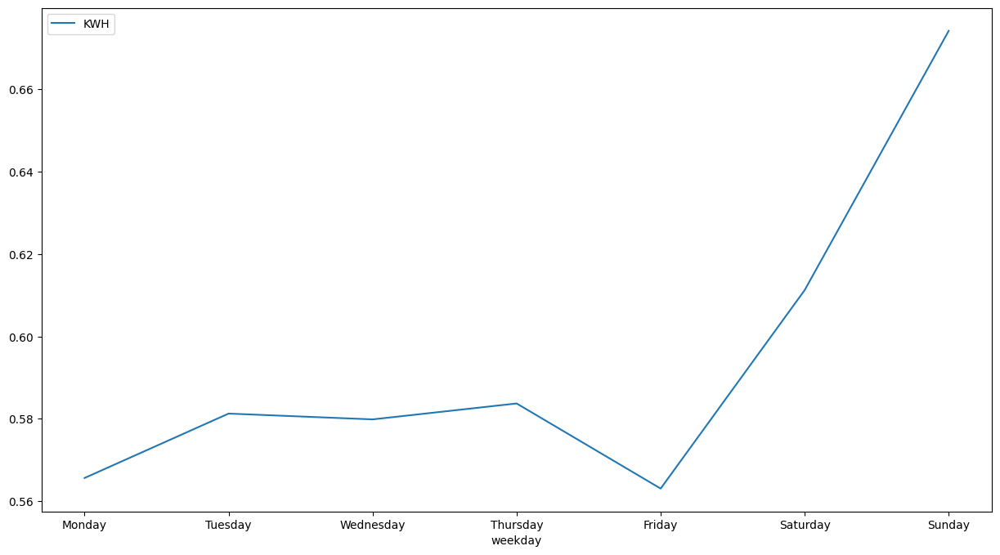

In [20]:
user_1[['KWH','weekday']].groupby('weekday').mean().plot();

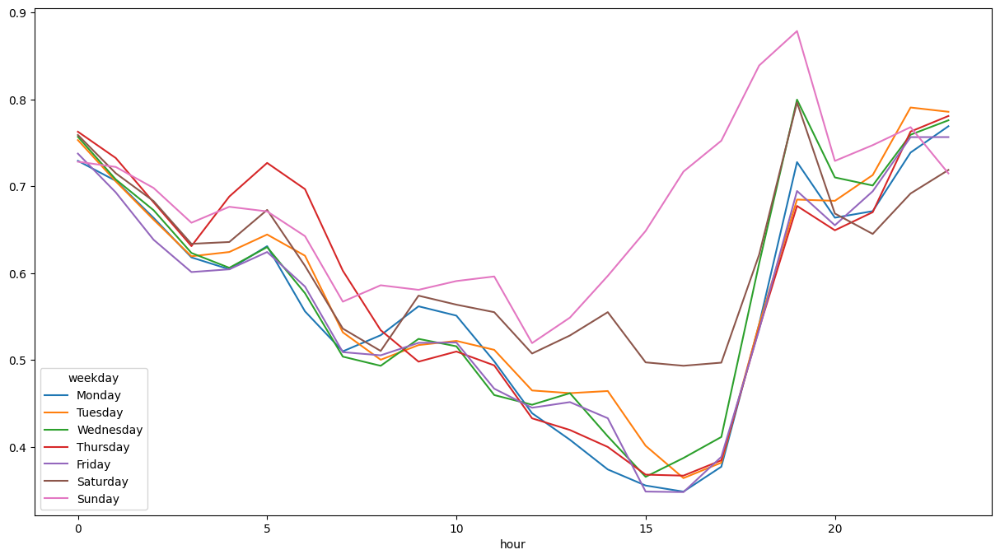

In [21]:
user_1.groupby(['hour', 'weekday']).mean()['KWH'].unstack().plot();

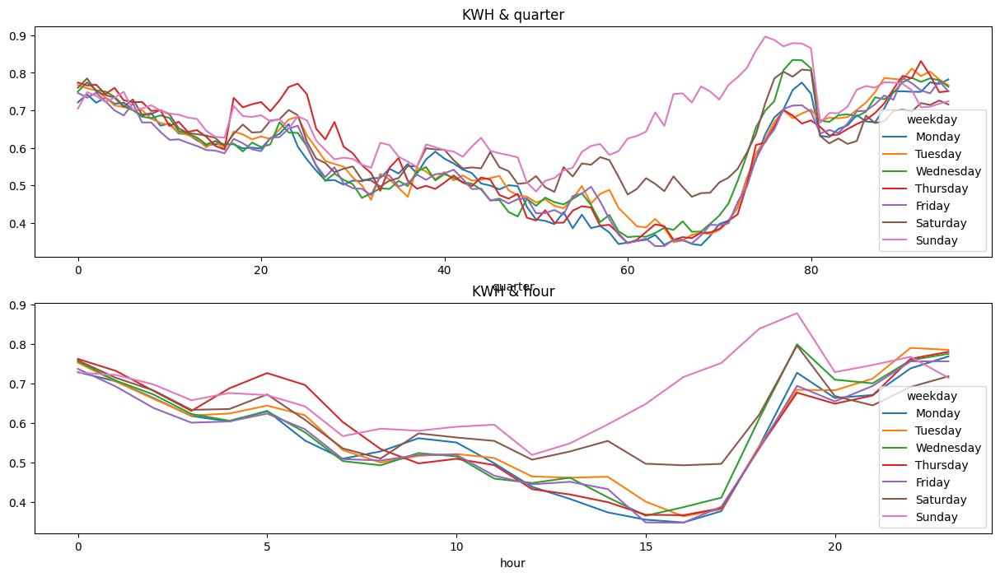

In [22]:
fig, axs = plt.subplots(2)

user_1.groupby(['quarter', 'weekday']).mean()['KWH'].unstack().plot(ax=axs[0]);
user_1.groupby(['hour', 'weekday']).mean()['KWH'].unstack().plot(ax=axs[1]);

axs[0].set_title('KWH & quarter')
axs[1].set_title('KWH & hour')
plt.show()

In [23]:
user_1.groupby(['quarter', 'weekday'])['KWH'].mean()

quarter  weekday  
0        Monday       0.721346
         Tuesday      0.767942
         Wednesday    0.750192
         Thursday     0.774115
         Friday       0.746453
                        ...   
95       Wednesday    0.763058
         Thursday     0.751250
         Friday       0.750981
         Saturday     0.715519
         Sunday       0.724231
Name: KWH, Length: 672, dtype: float64

In [24]:
user_1.join(user_1.groupby(['quarter', 'weekday'])['KWH'].mean(), on=['quarter','weekday'], rsuffix='_avg')

,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg
0,2021-01-01 00:00:00,0.602,0,0,Friday,night,0.746453
1,2021-01-01 00:15:00,0.589,1,0,Friday,night,0.733811
2,2021-01-01 00:30:00,0.410,2,0,Friday,night,0.746679
3,2021-01-01 00:45:00,0.495,3,0,Friday,night,0.724226
4,2021-01-01 01:00:00,0.450,4,1,Friday,night,0.699981
...,...,...,...,...,...,...,...
35035,2021-12-31 22:45:00,0.405,91,22,Friday,night,0.772604
35036,2021-12-31 23:00:00,0.349,92,23,Friday,night,0.753113
35037,2021-12-31 23:15:00,0.305,93,23,Friday,night,0.745415
35038,2021-12-31 23:30:00,0.398,94,23,Friday,night,0.777698


In [25]:
df_final_user_1 = user_1.join(user_1.groupby(['quarter', 'weekday'])['KWH'].mean(), on=['quarter','weekday'], rsuffix='_avg')
df_final_user_1

,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg
0,2021-01-01 00:00:00,0.602,0,0,Friday,night,0.746453
1,2021-01-01 00:15:00,0.589,1,0,Friday,night,0.733811
2,2021-01-01 00:30:00,0.410,2,0,Friday,night,0.746679
3,2021-01-01 00:45:00,0.495,3,0,Friday,night,0.724226
4,2021-01-01 01:00:00,0.450,4,1,Friday,night,0.699981
...,...,...,...,...,...,...,...
35035,2021-12-31 22:45:00,0.405,91,22,Friday,night,0.772604
35036,2021-12-31 23:00:00,0.349,92,23,Friday,night,0.753113
35037,2021-12-31 23:15:00,0.305,93,23,Friday,night,0.745415
35038,2021-12-31 23:30:00,0.398,94,23,Friday,night,0.777698


## Anomalous Point

```
NYC Marathon - 2014-11-02
Thanksgiving - 2014-11-27
Christmas - 2014-12-25
New Years - 2015-01-01
Snow Blizzard - 2015-01-26 and 2015-01-27
```

In [26]:
df_final_user_1['day'] = df_final_user_1['DATE-Time'].dt.weekday
df_final_user_1['period'] = df_final_user_1['DATE-Time'].apply(lambda x: 0 if 6 <= x.hour < 18 else 1)

df_final_user_1

,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg,day,period
0,2021-01-01 00:00:00,0.602,0,0,Friday,night,0.746453,4,1
1,2021-01-01 00:15:00,0.589,1,0,Friday,night,0.733811,4,1
2,2021-01-01 00:30:00,0.410,2,0,Friday,night,0.746679,4,1
3,2021-01-01 00:45:00,0.495,3,0,Friday,night,0.724226,4,1
4,2021-01-01 01:00:00,0.450,4,1,Friday,night,0.699981,4,1
...,...,...,...,...,...,...,...,...,...
35035,2021-12-31 22:45:00,0.405,91,22,Friday,night,0.772604,4,1
35036,2021-12-31 23:00:00,0.349,92,23,Friday,night,0.753113,4,1
35037,2021-12-31 23:15:00,0.305,93,23,Friday,night,0.745415,4,1
35038,2021-12-31 23:30:00,0.398,94,23,Friday,night,0.777698,4,1


In [27]:
df_final_user_1.isnull().sum()

DATE-Time       0
KWH             0
quarter         0
hour            0
weekday         0
day_or_night    0
KWH_avg         0
day             0
period          0
dtype: int64

In [28]:
data = df_final_user_1[['KWH', 'quarter', 'day']]
data

,KWH,quarter,day
0,0.602,0,4
1,0.589,1,4
2,0.410,2,4
3,0.495,3,4
4,0.450,4,4
...,...,...,...
35035,0.405,91,4
35036,0.349,92,4
35037,0.305,93,4
35038,0.398,94,4


# Train Model

In [29]:
model =  IsolationForest(contamination=0.005, max_features=3, max_samples=0.8, n_estimators=200, random_state=42)
model.fit(data)

IsolationForest(contamination=0.005, max_features=3, max_samples=0.8,
                n_estimators=200, random_state=42)

In [30]:
df_final_user_1['outliers']=pd.Series(model.predict(data)).apply(lambda x: 'yes' if (x == -1) else 'no' )

In [31]:
print("The anomaly events: ", len(df_final_user_1.query('outliers=="yes"')))
df_final_user_1.query('outliers=="yes"')

The anomaly events:  176


,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg,day,period,outliers
478,2021-01-05 23:30:00,1.687,94,23,Tuesday,night,0.782154,1,1,yes
777,2021-01-09 02:15:00,1.511,9,2,Saturday,night,0.701000,5,1,yes
864,2021-01-10 00:00:00,1.186,0,0,Sunday,night,0.704673,6,1,yes
959,2021-01-10 23:45:00,1.502,95,23,Sunday,night,0.724231,6,1,yes
994,2021-01-11 08:30:00,1.840,34,8,Monday,day,0.544231,0,0,yes
...,...,...,...,...,...,...,...,...,...,...
32303,2021-12-03 11:45:00,2.002,47,11,Friday,day,0.451755,4,0,yes
33830,2021-12-19 09:30:00,1.853,38,9,Sunday,day,0.609192,6,0,yes
33836,2021-12-19 11:00:00,1.791,44,11,Sunday,day,0.626827,6,0,yes
33889,2021-12-20 00:15:00,0.301,1,0,Monday,night,0.742577,0,1,yes


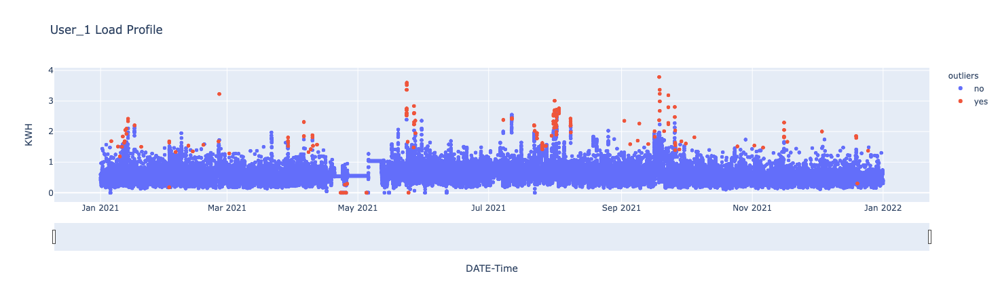

In [32]:
fig = px.scatter(df_final_user_1, x='DATE-Time', y='KWH', color='outliers', hover_data=['weekday','quarter','KWH_avg'], title='User_1 Load Profile')

fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

In [33]:
score = model.decision_function(data)
score

array([0.10510229, 0.12228019, 0.09726124, ..., 0.04386645, 0.08120381,
       0.0585838 ])

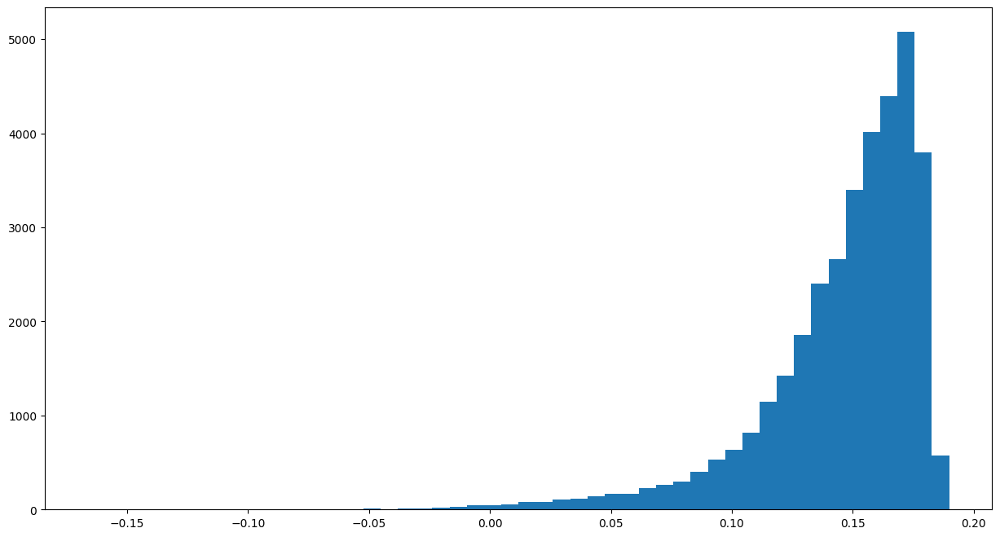

In [35]:
plt.hist(score, bins=50);

In [36]:
df_final_user_1['scores'] = score
df_final_user_1

,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg,day,period,outliers,scores
0,2021-01-01 00:00:00,0.602,0,0,Friday,night,0.746453,4,1,no,0.105102
1,2021-01-01 00:15:00,0.589,1,0,Friday,night,0.733811,4,1,no,0.122280
2,2021-01-01 00:30:00,0.410,2,0,Friday,night,0.746679,4,1,no,0.097261
3,2021-01-01 00:45:00,0.495,3,0,Friday,night,0.724226,4,1,no,0.118925
4,2021-01-01 01:00:00,0.450,4,1,Friday,night,0.699981,4,1,no,0.114876
...,...,...,...,...,...,...,...,...,...,...,...
35035,2021-12-31 22:45:00,0.405,91,22,Friday,night,0.772604,4,1,no,0.105651
35036,2021-12-31 23:00:00,0.349,92,23,Friday,night,0.753113,4,1,no,0.089843
35037,2021-12-31 23:15:00,0.305,93,23,Friday,night,0.745415,4,1,no,0.043866
35038,2021-12-31 23:30:00,0.398,94,23,Friday,night,0.777698,4,1,no,0.081204


In [37]:
print("The anomaly events: ", len(df_final_user_1.query('scores<-0.02')))
df_final_user_1.query('scores<-0.02')

The anomaly events:  83


,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg,day,period,outliers,scores
478,2021-01-05 23:30:00,1.687,94,23,Tuesday,night,0.782154,1,1,yes,-0.066838
959,2021-01-10 23:45:00,1.502,95,23,Sunday,night,0.724231,6,1,yes,-0.052020
994,2021-01-11 08:30:00,1.840,34,8,Monday,day,0.544231,0,0,yes,-0.053775
1053,2021-01-11 23:15:00,1.632,93,23,Monday,night,0.774673,0,1,yes,-0.047878
1107,2021-01-12 12:45:00,2.049,51,12,Tuesday,day,0.462654,1,0,yes,-0.075535
...,...,...,...,...,...,...,...,...,...,...,...
29665,2021-11-06 00:15:00,1.475,1,0,Saturday,night,0.785269,5,1,yes,-0.028207
30606,2021-11-15 19:30:00,2.294,78,19,Monday,night,0.754115,0,1,yes,-0.056015
30607,2021-11-15 19:45:00,2.052,79,19,Monday,night,0.774231,0,1,yes,-0.033340
32303,2021-12-03 11:45:00,2.002,47,11,Friday,day,0.451755,4,0,yes,-0.028407


In [38]:
df_final_user_1['outliers_new'] = pd.Series(df_final_user_1['scores'] <= -0.02).apply(lambda x: 'yes' if (x == True) else 'no' )
df_final_user_1

,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg,day,period,outliers,scores,outliers_new
0,2021-01-01 00:00:00,0.602,0,0,Friday,night,0.746453,4,1,no,0.105102,no
1,2021-01-01 00:15:00,0.589,1,0,Friday,night,0.733811,4,1,no,0.122280,no
2,2021-01-01 00:30:00,0.410,2,0,Friday,night,0.746679,4,1,no,0.097261,no
3,2021-01-01 00:45:00,0.495,3,0,Friday,night,0.724226,4,1,no,0.118925,no
4,2021-01-01 01:00:00,0.450,4,1,Friday,night,0.699981,4,1,no,0.114876,no
...,...,...,...,...,...,...,...,...,...,...,...,...
35035,2021-12-31 22:45:00,0.405,91,22,Friday,night,0.772604,4,1,no,0.105651,no
35036,2021-12-31 23:00:00,0.349,92,23,Friday,night,0.753113,4,1,no,0.089843,no
35037,2021-12-31 23:15:00,0.305,93,23,Friday,night,0.745415,4,1,no,0.043866,no
35038,2021-12-31 23:30:00,0.398,94,23,Friday,night,0.777698,4,1,no,0.081204,no


In [39]:
print("The anomaly events: ", len(df_final_user_1.query('outliers_new == "yes"')))
df_final_user_1.query('outliers_new == "yes"')

The anomaly events:  83


,DATE-Time,KWH,quarter,hour,weekday,day_or_night,KWH_avg,day,period,outliers,scores,outliers_new
478,2021-01-05 23:30:00,1.687,94,23,Tuesday,night,0.782154,1,1,yes,-0.066838,yes
959,2021-01-10 23:45:00,1.502,95,23,Sunday,night,0.724231,6,1,yes,-0.052020,yes
994,2021-01-11 08:30:00,1.840,34,8,Monday,day,0.544231,0,0,yes,-0.053775,yes
1053,2021-01-11 23:15:00,1.632,93,23,Monday,night,0.774673,0,1,yes,-0.047878,yes
1107,2021-01-12 12:45:00,2.049,51,12,Tuesday,day,0.462654,1,0,yes,-0.075535,yes
...,...,...,...,...,...,...,...,...,...,...,...,...
29665,2021-11-06 00:15:00,1.475,1,0,Saturday,night,0.785269,5,1,yes,-0.028207,yes
30606,2021-11-15 19:30:00,2.294,78,19,Monday,night,0.754115,0,1,yes,-0.056015,yes
30607,2021-11-15 19:45:00,2.052,79,19,Monday,night,0.774231,0,1,yes,-0.033340,yes
32303,2021-12-03 11:45:00,2.002,47,11,Friday,day,0.451755,4,0,yes,-0.028407,yes


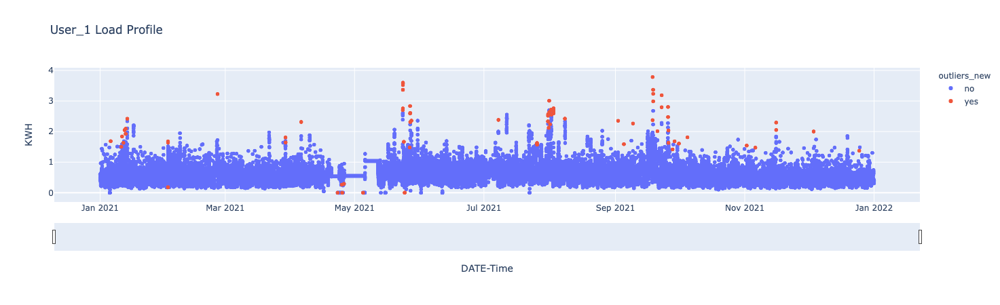

In [40]:
fig = px.scatter(df_final_user_1, x='DATE-Time', y='KWH', color='outliers_new', hover_data=['weekday','quarter','KWH_avg'], title='User_1 Load Profile')

fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

## Using GridSearchCV to find the best params

In [46]:
from sklearn.model_selection import GridSearchCV

# create an IsolationForest object
iforest = IsolationForest()

# specify the hyperparameter grid to search over
param_grid = {
    "n_estimators": np.arange(50, 251, 50),
    "max_samples": np.arange(0.1, 1.1, 0.1),
    "contamination": [0.005, 0.01, 0.05, 0.1, 0.15, 0.2]
}

# create a GridSearchCV object
grid_search = GridSearchCV(iforest, param_grid, scoring='roc_auc', cv=10)

# fit the GridSearchCV object to the data
grid_search.fit(data)

# print the best parameters found by GridSearchCV
print(grid_search.best_params_)

{'contamination': 0.005, 'max_samples': 0.1, 'n_estimators': 50}


## After GridSearch

In [ ]:
model_gridsearch =  IsolationForest(contamination=0.005, max_features=3, max_samples=0.1, n_estimators=50, random_state=42)
model_gridsearch.fit(data)

In [ ]:
df_final_user_1['outliers']=pd.Series(model_gridsearch.predict(data)).apply(lambda x: 'yes' if (x == -1) else 'no' )

In [ ]:
print("The anomaly events: ", len(df_final_user_1.query('outliers=="yes"')))
df_final_user_1.query('outliers=="yes"')

In [ ]:
fig = px.scatter(df_final_user_1, x='DATE-Time', y='KWH', color='outliers', hover_data=['weekday','quarter','KWH_avg'], title='User_1 Load Profile')

fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

In [ ]:
score = model_gridsearch.decision_function(data)
score

In [ ]:
plt.hist(score, bins=50);

In [ ]:
df_final_user_1['scores'] = score
df_final_user_1

In [ ]:
df_final_user_1['outliers_new'] = pd.Series(df_final_user_1['scores'] <= -0.02).apply(lambda x: 'yes' if (x == True) else 'no' )
df_final_user_1

In [ ]:
print("The anomaly events: ", len(df_final_user_1.query('outliers_new == "yes"')))
df_final_user_1.query('outliers_new == "yes"')

In [ ]:
fig = px.scatter(df_final_user_1, x='DATE-Time', y='KWH', color='outliers_new', hover_data=['weekday','quarter','KWH_avg'], title='User_1 Load Profile')

fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()